In [1]:
import os
import scipy.io
import numpy as np

import xgboost as xgb
import lightgbm as lgb
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import AdaBoostClassifier

from sklearn.model_selection import train_test_split #to split the dataset for training and testing
from sklearn.svm import SVC   #for Support Vector Machine (SVM) Algorithm

from sklearn import preprocessing
from sklearn import metrics
from sklearn.ensemble import RandomForestClassifier

from sklearn.neighbors import KNeighborsClassifier  # for K nearest neighbours
from sklearn.tree import DecisionTreeClassifier #for using Decision Tree Algoithm


import tensorflow as tf
from keras.utils.vis_utils import plot_model
from keras.preprocessing.sequence import TimeseriesGenerator

from keras.models import Sequential
from keras.layers import Dense, Flatten, Dropout, Conv1D, Conv2D, Conv3D, MaxPooling1D, MaxPooling2D, Rescaling

from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

import pickle


In [2]:

import pickle
with open('IB_eeg_data.pkl', 'rb') as f:
    epochs, triggers, groups, phase, stim, subj  = pickle.load(f)


In [3]:
import numpy as np

def filter_data(epochs, labels, phase, stim, subj, triggers, interested_triggers):
    labels = lbl_clf.fit_transform(labels)
    
    # Convert triggers and interested_triggers to NumPy arrays
    triggers = np.array(triggers)
    interested_triggers = np.array(interested_triggers)
    
    # Create a boolean mask for interested triggers
    mask = np.isin(triggers, interested_triggers)
    
    # Apply the mask to filter the data
    filtered_epochs = epochs[:, :, mask]
    filtered_labels = labels[mask]
    filtered_triggers = triggers[mask]
    
    return filtered_epochs, filtered_triggers, filtered_labels, filtered_stim, filtered_subj, filtered_phase

# Example usage
# epochs = np.random.rand(64, 1000, 10)  # Example epochs data
# labels = np.array(['label1', 'label2', 'label3', 'label1', 'label2', 'label3', 'label1', 'label2', 'label3', 'label1'])
# triggers = np.array([1, 2, 3, 1, 2, 3, 1, 2, 3, 1])
# interested_triggers = [1, 3]

# filtered_epochs, filtered_triggers, filtered_labels = filter_data(epochs, labels, triggers, interested_triggers)
# print(filtered_epochs.shape, filtered_triggers, filtered_labels)


In [4]:
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import mne
from mne.stats import permutation_cluster_test
from scipy.stats import ttest_ind


class DataFilter:
    def __init__(self, epochs, groups, phase, stim, subj, triggers):
        self.epochs = epochs
        self.groups = groups
        self.phase = phase
        self.stim = stim
        self.subj = subj
        self.triggers = triggers

    def filter_data(self, variable_name, values, include=True):
        # Get the variable to filter on
        variable = getattr(self, variable_name)

        # Convert to NumPy array for consistency
        variable = np.array(variable)
        
        # Create a boolean mask
        if include:
            mask = np.isin(variable, values)
        else:
            mask = ~np.isin(variable, values)

        # Apply the mask to filter the data
        self.epochs = self.epochs[:, :, mask]
        self.groups = self.groups[mask]
        self.phase = np.array(self.phase)[mask]
        self.stim = np.array(self.stim)[mask]
        self.subj = np.array(self.subj)[mask]
        self.triggers = np.array(self.triggers)[mask]

    def get_filtered_data(self):
        return self.epochs, self.groups, self.phase, self.stim, self.subj, self.triggers

    def compute_average_erps(self):
        unique_subjects = np.unique(self.subj)
        unique_triggers = np.unique(self.triggers)
        
        for subj in unique_subjects:
            subj_erps = []
            for trigger in unique_triggers:
                subj_trigger_epochs = self.epochs[:, :, (self.subj == subj) & (self.triggers == trigger)]
                avg_erp = np.mean(subj_trigger_epochs, axis=2)
                subj_erps.append(avg_erp)
            self.average_erps[subj] = subj_erps

    def get_average_erp(self, subj, trigger):
        subj_erps = self.average_erps.get(subj, None)
        if subj_erps is not None:
            return subj_erps[trigger]
        else:
            return None

    def cluster_test(self, channel, trigger_set1, trigger_set2):
            mask1 = np.isin(self.triggers, trigger_set1)
            print(mask1)
            mask2 = np.isin(self.triggers, trigger_set2)
            print(mask2)

            data1 = self.epochs[:, :, mask1]
            data2 = self.epochs[:, :, mask2]

            #data1 = np.expand_dims(data1,0)
            #data2 = np.expand_dims(data2,0)

            print(data1.shape)

            data = [data1.transpose(2, 0, 1), data2.transpose(2, 0, 1)]

            # Run the cluster-based permutation test
            T_obs, clusters, cluster_p_values, H0 = permutation_cluster_test(
                data, n_permutations=1000, tail=0, n_jobs=-1, threshold=None, 
                out_type='mask'
            )

                # Store cluster information
            self.T_obs = T_obs
            self.clusters = clusters
            self.cluster_p_values = cluster_p_values
            self.H0 = H0


# # Example usage
# epochs = np.random.rand(64, 1000, 10)  # Example epochs data
# labels = np.array(['label1', 'label2', 'label3', 'label1', 'label2', 'label3', 'label1', 'label2', 'label3', 'label1'])
# phase = np.array(['phase1', 'phase2', 'phase3', 'phase1', 'phase2', 'phase3', 'phase1', 'phase2', 'phase3', 'phase1'])
# stim = np.array(['face', 'house', 'noise', 'face', 'house', 'noise', 'face', 'house', 'noise', 'face'])
# subj = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10])
# triggers = np.array([1, 2, 3, 1, 2, 3, 1, 2, 3, 1])

data_filter = DataFilter(epochs, groups, phase, stim, subj, triggers)

# # Filter out subject 5 and only include phases 1 and 2, and only faces in stim
# data_filter.filter_data('subj', [5], include=False)
# data_filter.filter_data('phase', ['phase1', 'phase2'], include=True)
# data_filter.filter_data('stim', ['face'], include=True)

# filtered_epochs, filtered_labels, filtered_phase, filtered_stim, filtered_subj, filtered_triggers = data_filter.get_filtered_data()

# print(filtered_epochs.shape, filtered_labels, filtered_phase, filtered_stim, filtered_subj, filtered_triggers)


In [5]:
# Plot the results
plt.figure(figsize=(10, 6))
times = np.arange(data1.shape[0])
for i_c, c in enumerate(clusters):
    c = c[0]
    if cluster_p_values[i_c] <= 0.05:
        h = plt.axvspan(times[c.start], times[c.stop - 1], color='r', alpha=0.3)
plt.plot(times, data1.mean(axis=1) - data2.mean(axis=1), label='Difference')
plt.legend()
plt.title(f'Cluster-based permutation test results for channel {channel}')
plt.xlabel('Time (samples)')
plt.ylabel('ERP Difference')
plt.show()

NameError: name 'data1' is not defined

<Figure size 1000x600 with 0 Axes>

In [ ]:
import numpy as np
import mne
from mne.stats import permutation_cluster_test

# Simulated data for two conditions
n_channels = 64
n_times = 1000
n_epochs = 100

# Create random ERP data for two conditions
data_condition1 = np.random.rand(n_epochs, n_channels, n_times)
data_condition2 = np.random.rand(n_epochs, n_channels, n_times)

# Create the list of data arrays
X = [data_condition1, data_condition2]

# Perform the permutation cluster test
T_obs, clusters, cluster_p_values, H0 = permutation_cluster_test(
    X, n_permutations=1000, tail=0, n_jobs=1
)

# Output the results
print("T_obs:", T_obs.shape)
print("Clusters:", len(clusters))
print("Cluster p-values:", cluster_p_values)
print("H0:", H0)


Using a threshold of 3.888853
stat_fun(H1): min=0.000000 max=23.024294
Running initial clustering …


C:\Users\User\AppData\Local\Temp\ipykernel_19948\15324593.py:18: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = permutation_cluster_test(


Found 2872 clusters


  0%|          | Permuting : 3/999 [00:00<04:07,    4.03it/s]


PermissionError: [WinError 32] The process cannot access the file because it is being used by another process: 'C:\\Users\\User\\AppData\\Local\\Temp\\tmp_mne_progr7wm1v7s'

In [6]:
save_data = data_filter.cluster_test(8, 210, 211)


# Save the data
with open('IB_cluster_data.pkl', 'wb') as f:
    pickle.dump((save_data), f)

[ True  True  True ... False False False]
[False False False ... False False False]
(63, 1250, 10048)
Using a threshold of 3.841921


C:\Users\User\AppData\Local\Temp\ipykernel_29008\619609553.py:78: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  T_obs, clusters, cluster_p_values, H0 = permutation_cluster_test(


stat_fun(H1): min=-0.000409 max=41.074825
Running initial clustering …
Found 1391 clusters


c:\ProgramData\anaconda3\envs\tensorflow-gpu\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
  0%|          | Permuting : 0/999 [01:39<?,       ?it/s]


PicklingError: Could not pickle the task to send it to the workers.

In [4]:

# Example usage

interested_triggers = [201, 211, 212,220, 221, 222, 230, 231, 232]

interested_triggers = [220, 221, 222, 230, 231, 232]
interested_triggers = [210,211]

# Assuming epochs and triggers are already loaded or processed
X, filtered_trigers, y = filter_data(epochs, labels, triggers, interested_triggers)

print("Filtered epochs shape:", X.shape)
print("Filtered labels shape:", y.shape)

Filtered epochs shape: (20131, 63, 1250)
Filtered labels shape: (20131,)


In [5]:

##  DEFINING MODELS TO BE RUN
is_cnn = False
#models = [cnn]
#models_name = ['CNN']

haar = False
lda = LinearDiscriminantAnalysis()
logreg = LogisticRegression(max_iter=10000)
linreg_model = LinearRegression()

# Create a Decision Tree stump as a base estimator
base_estimator = DecisionTreeClassifier(max_depth=1)

# Create an AdaBoostClassifier with the Decision Tree stump as the base estimator
adaBoost = AdaBoostClassifier(estimator=base_estimator, n_estimators=100)

XGB_model = xgb.XGBClassifier(n_estimators=100, max_depth=1)
LGB_model = lgb.LGBMClassifier(n_estimators=400, max_depth=20,num_leaves=20,n_jobs=-1,verbose=-1)
forest = RandomForestClassifier(n_estimators=2000,criterion="entropy",random_state=0,n_jobs=-1)
knn = KNeighborsClassifier(n_neighbors=22, n_jobs=-1)
svc_poly = SVC(kernel='poly',gamma='scale')
svc_rbf = SVC(kernel='rbf',gamma='scale')
svc_sigmoid = SVC(kernel='sigmoid',gamma='scale')
svc = SVC(kernel='linear',gamma='scale')

## DEFFINING THE CHOICES FOR THE MODELS
models = [logreg]
models_names = [model.__class__.__name__ for model in models]
#models_name = ['LogReg']

step_size = [5]
window_sizes = [20]
windows = [n for n in window_sizes]
channels = [1,5,14]
mods = 'raw'
avgs = [8]
percent = 100

#if file_name.find('deNoised'):
mods = 'IB_face_house_test1'
#if haar:
#    mods = mods + 'haar'

window_of_time = [0,300]  # default -100 500
win_size = np.shape(windows)


In [6]:
X_cut = X[:,:,500:1000]

In [7]:
X_reshaped = X_cut.reshape(X_cut.shape[0],X_cut.shape[1]*X_cut.shape[2])

X_train, X_test, y_train, y_test = train_test_split(X_reshaped, y, test_size=0.2, random_state=42)


In [8]:


std_clf = StandardScaler() # standardize the data

scaler = StandardScaler()

y_array = np.array(y)

y_cnn = tf.keras.utils.to_categorical(y_array)

X_cnn = scaler.fit_transform(X_cut.reshape(-1, X_cut.shape[-1])).reshape(X_cut.shape)

X_train, X_test, y_train, y_test = train_test_split(X_cnn, y_cnn, test_size=0.2, random_state=42)


In [9]:

tf.keras.backend.clear_session() # if we dont do that, if you would rerun this, it would take the previous model

model = tf.keras.models.Sequential() # sequential mode 99% of the time;

model.add(Rescaling(1/150,input_shape=(X_train.shape[1:])))
#model.add(Flatten(input_shape=(X_train.shape[1], X_train.shape[2])))
model.add(Conv1D(64,20,activation='relu',input_shape=(X_train.shape[1:])))

model.add(MaxPooling1D(pool_size=(2)))

model.add(Dropout(0.15))

model.add(Conv1D(128,10,activation='relu',input_shape=(X_train.shape[1:])))

model.add(MaxPooling1D(pool_size=(1)))
#model.add(Flatten(input_shape=(x_train_new.shape[1], x_train_new.shape[2])))

#model.add(tf.keras.layers.Dense(5, name='hidden')) # add layers
#model.add(Dense(64, activation='relu'))
model.add(Dropout(0.15))
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.15))
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.15))
model.add(Dense(32, activation='relu'))
#model.add(Dropout(0.3))
model.add(Flatten())

#model.add(tf.keras.layers.Dense(50, input_dim=91, name='hidden2')) # add layers
model.add(tf.keras.layers.Dense(y_train.shape[1], activation='sigmoid', name='output'))

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
#model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [10]:
num_epochs = 20        # how many times to run the entire training dataset
validation_split = 0.25  # how much data from training to use for validation
batch_size = 5          # set to how many jobs to feed forward before adjusting weights
                         # stochastic gradient descent = update weights each obs
                         # mini-batch gradient descent = update weights after a batch size of obs
                         # batch gradient descent - update after all obs
                         # mini-batch is a balance, not as precise on adjustments but faster            
verbose = 1              # 0/1/2 (how much information during training, 0=none, 1=alot)

# important
# here we are fitting the model once
# good idea to run neural net model lots of times with random weights each time and average overall results
history = model.fit(X_train, y_train, epochs=num_epochs, batch_size=batch_size, verbose=verbose,validation_split=validation_split)
#model.evaluate(X_test, y_test)

Epoch 1/20
2416/2416 [==============================] - 20s 5ms/step - loss: 0.6586 - accuracy: 0.6139 - val_loss: 0.6274 - val_accuracy: 0.6458
Epoch 2/20
2416/2416 [==============================] - 11s 5ms/step - loss: 0.5999 - accuracy: 0.6788 - val_loss: 0.5789 - val_accuracy: 0.7012
Epoch 3/20
2416/2416 [==============================] - 11s 5ms/step - loss: 0.5273 - accuracy: 0.7352 - val_loss: 0.5342 - val_accuracy: 0.7283
Epoch 4/20
2416/2416 [==============================] - 11s 5ms/step - loss: 0.4472 - accuracy: 0.7865 - val_loss: 0.5252 - val_accuracy: 0.7380
Epoch 5/20
2416/2416 [==============================] - 11s 5ms/step - loss: 0.3708 - accuracy: 0.8313 - val_loss: 0.5189 - val_accuracy: 0.7394
Epoch 6/20
2416/2416 [==============================] - 11s 5ms/step - loss: 0.3197 - accuracy: 0.8597 - val_loss: 0.5506 - val_accuracy: 0.7462
Epoch 7/20
2416/2416 [==============================] - 11s 5ms/step - loss: 0.2755 - accuracy: 0.8797 - val_loss: 0.5984 - val_ac

In [11]:
model.evaluate(X_test, y_test)

126/126 [==============================] - 1s 4ms/step - loss: 0.7709 - accuracy: 0.7586


[0.7709150910377502, 0.7586292624473572]

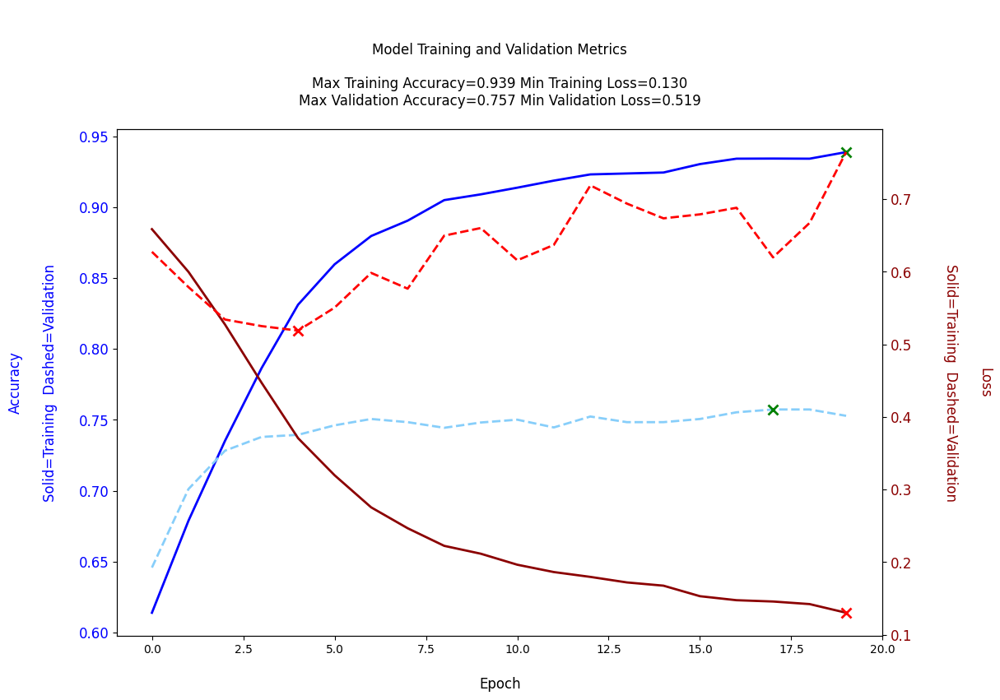

In [12]:
fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(111)

ind_xta = np.argmax(history.history['accuracy'])
ind_xva = np.argmax(history.history['val_accuracy'])
ind_xtl = np.argmin(history.history['loss'])
ind_xvl = np.argmin(history.history['val_loss'])

plt.title('\n\nModel Training and Validation Metrics\n\n' +
          'Max Training Accuracy='+str("%.3f" % history.history['accuracy'][ind_xta])+' ' +
          'Min Training Loss='+str("%.3f" % history.history['loss'][ind_xtl])+'\n'+
          'Max Validation Accuracy='+str("%.3f" % history.history['val_accuracy'][ind_xva])+' ' +
          'Min Validation Loss='+str("%.3f" % history.history['val_loss'][ind_xvl])+'\n',size=12)

ax1.plot(history.history['accuracy'], color='blue', linestyle='-',linewidth=2)
plt.plot(history.history['val_accuracy'], color='lightskyblue', linestyle='--',linewidth=2)

ax1.set_xlabel('\nEpoch', size=12)
ax1.set_ylabel('Accuracy\n\nSolid=Training  Dashed=Validation\n', color='blue',size=12)
ax1.set_xlim(right=num_epochs)

plt.plot(ind_xta, history.history['accuracy'][ind_xta], 'gx', markersize=8, markeredgewidth=2)
plt.plot(ind_xva, history.history['val_accuracy'][ind_xva], 'gx', markersize=8, markeredgewidth=2)

for tl in ax1.get_yticklabels():
    tl.set_color('blue')
    tl.set_fontsize(12)
    
ax2 = ax1.twinx()
ax2.plot(history.history['loss'], color='darkred', linestyle='-',linewidth=2)
plt.plot(history.history['val_loss'], color='red', linestyle='--',linewidth=2)

ax2.set_ylabel('Loss\n\nSolid=Training  Dashed=Validation\n', color='darkred',size=12, rotation=270, labelpad=70)
plt.plot(ind_xtl, history.history['loss'][ind_xtl], 'rx', markersize=8, markeredgewidth=2)
plt.plot(ind_xvl, history.history['val_loss'][ind_xvl], 'rx', markersize=8, markeredgewidth=2)

for tl in ax2.get_yticklabels():
    tl.set_color('darkred')
    tl.set_fontsize(12)

This is a CONV 2D

In [18]:
std_clf = StandardScaler() # standardize the data

scaler = StandardScaler()

y_array = np.array(y)

y_cnn = tf.keras.utils.to_categorical(y_array)

X_train, X_test, y_train, y_test = train_test_split(X_cut, y_cnn, test_size=0.2, random_state=42)

X_train = np.expand_dims(X_train,3)
X_test = np.expand_dims(X_test,3)


In [19]:

tf.keras.backend.clear_session() # if we dont do that, if you would rerun this, it would take the previous model

model = tf.keras.models.Sequential() # sequential mode 99% of the time;

model.add(Rescaling(1/150,input_shape=(X_train.shape[1:])))
#model.add(Flatten(input_shape=(X_train.shape[1], X_train.shape[2])))
model.add(Conv2D(64,(3,10),activation='relu',input_shape=(X_train.shape[1:])))

model.add(MaxPooling2D(pool_size=(3,3)))

model.add(Dropout(0.15))

model.add(Conv2D(64,(3,10),activation='relu',input_shape=(X_train.shape[1:])))

model.add(MaxPooling2D(pool_size=(3,3)))
#model.add(Flatten(input_shape=(x_train_new.shape[1], x_train_new.shape[2])))

#model.add(tf.keras.layers.Dense(5, name='hidden')) # add layers
#model.add(Dense(64, activation='relu'))
model.add(Dropout(0.15))
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.15))
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.15))
model.add(Dense(32, activation='relu'))
#model.add(Dropout(0.3))
model.add(Flatten())

#model.add(tf.keras.layers.Dense(50, input_dim=91, name='hidden2')) # add layers
model.add(tf.keras.layers.Dense(y_train.shape[1], activation='sigmoid', name='output'))

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
#model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [20]:
num_epochs = 20        # how many times to run the entire training dataset
validation_split = 0.25  # how much data from training to use for validation
batch_size = 5          # set to how many jobs to feed forward before adjusting weights
                         # stochastic gradient descent = update weights each obs
                         # mini-batch gradient descent = update weights after a batch size of obs
                         # batch gradient descent - update after all obs
                         # mini-batch is a balance, not as precise on adjustments but faster            
verbose = 1              # 0/1/2 (how much information during training, 0=none, 1=alot)

# important
# here we are fitting the model once
# good idea to run neural net model lots of times with random weights each time and average overall results
history = model.fit(X_train, y_train, epochs=num_epochs, batch_size=batch_size, verbose=verbose,validation_split=validation_split)
#model.evaluate(X_test, y_test)

Epoch 1/20
2416/2416 [==============================] - 20s 8ms/step - loss: 0.6667 - accuracy: 0.5984 - val_loss: 0.6583 - val_accuracy: 0.6172
Epoch 2/20
2416/2416 [==============================] - 19s 8ms/step - loss: 0.5809 - accuracy: 0.6985 - val_loss: 0.5074 - val_accuracy: 0.7516
Epoch 3/20
2416/2416 [==============================] - 19s 8ms/step - loss: 0.4498 - accuracy: 0.7890 - val_loss: 0.4286 - val_accuracy: 0.8023
Epoch 4/20
2416/2416 [==============================] - 19s 8ms/step - loss: 0.3594 - accuracy: 0.8379 - val_loss: 0.3498 - val_accuracy: 0.8462
Epoch 5/20
2416/2416 [==============================] - 19s 8ms/step - loss: 0.3111 - accuracy: 0.8636 - val_loss: 0.2720 - val_accuracy: 0.8788
Epoch 6/20
2416/2416 [==============================] - 19s 8ms/step - loss: 0.2779 - accuracy: 0.8804 - val_loss: 0.2848 - val_accuracy: 0.8820
Epoch 7/20
2416/2416 [==============================] - 19s 8ms/step - loss: 0.2454 - accuracy: 0.8920 - val_loss: 0.3248 - val_ac

In [21]:
model.evaluate(X_test, y_test)

126/126 [==============================] - 2s 11ms/step - loss: 0.1858 - accuracy: 0.9136


[0.1857501119375229, 0.9135833382606506]

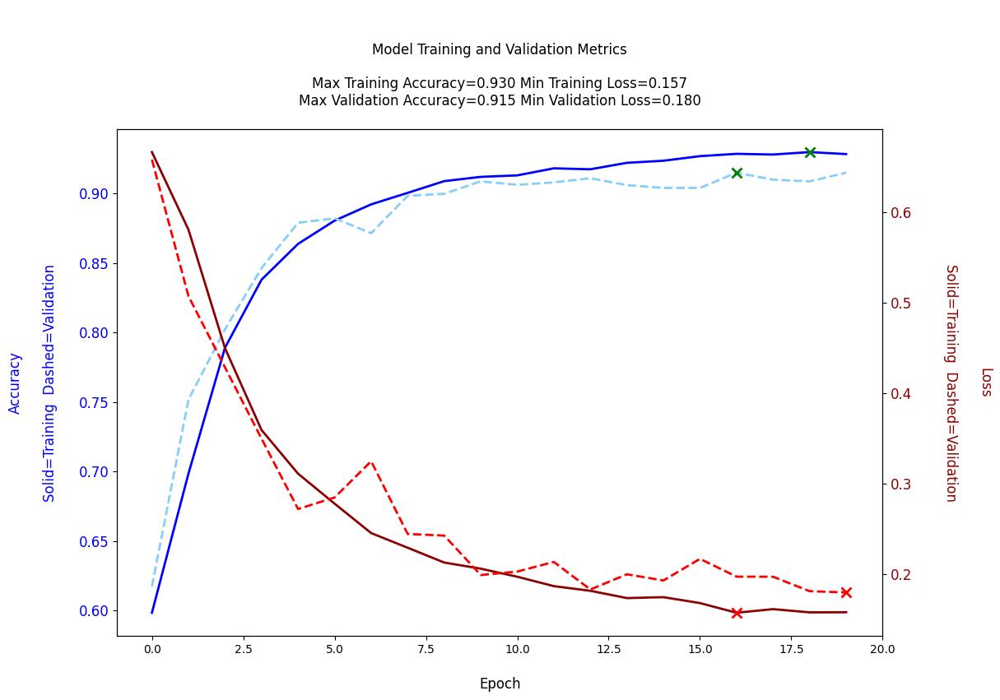

In [22]:
fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(111)

ind_xta = np.argmax(history.history['accuracy'])
ind_xva = np.argmax(history.history['val_accuracy'])
ind_xtl = np.argmin(history.history['loss'])
ind_xvl = np.argmin(history.history['val_loss'])

plt.title('\n\nModel Training and Validation Metrics\n\n' +
          'Max Training Accuracy='+str("%.3f" % history.history['accuracy'][ind_xta])+' ' +
          'Min Training Loss='+str("%.3f" % history.history['loss'][ind_xtl])+'\n'+
          'Max Validation Accuracy='+str("%.3f" % history.history['val_accuracy'][ind_xva])+' ' +
          'Min Validation Loss='+str("%.3f" % history.history['val_loss'][ind_xvl])+'\n',size=12)

ax1.plot(history.history['accuracy'], color='blue', linestyle='-',linewidth=2)
plt.plot(history.history['val_accuracy'], color='lightskyblue', linestyle='--',linewidth=2)

ax1.set_xlabel('\nEpoch', size=12)
ax1.set_ylabel('Accuracy\n\nSolid=Training  Dashed=Validation\n', color='blue',size=12)
ax1.set_xlim(right=num_epochs)

plt.plot(ind_xta, history.history['accuracy'][ind_xta], 'gx', markersize=8, markeredgewidth=2)
plt.plot(ind_xva, history.history['val_accuracy'][ind_xva], 'gx', markersize=8, markeredgewidth=2)

for tl in ax1.get_yticklabels():
    tl.set_color('blue')
    tl.set_fontsize(12)
    
ax2 = ax1.twinx()
ax2.plot(history.history['loss'], color='darkred', linestyle='-',linewidth=2)
plt.plot(history.history['val_loss'], color='red', linestyle='--',linewidth=2)

ax2.set_ylabel('Loss\n\nSolid=Training  Dashed=Validation\n', color='darkred',size=12, rotation=270, labelpad=70)
plt.plot(ind_xtl, history.history['loss'][ind_xtl], 'rx', markersize=8, markeredgewidth=2)
plt.plot(ind_xvl, history.history['val_loss'][ind_xvl], 'rx', markersize=8, markeredgewidth=2)

for tl in ax2.get_yticklabels():
    tl.set_color('darkred')
    tl.set_fontsize(12)

In [23]:
import pandas as pd

def transform_data_3D(data_all, headmodel):


    file_location = "C:\\GitHub\\Triangulation\\BioSemi64.csv"

    map = pd.read_csv(headmodel,skiprows=0)

    map = np.array(map)

    print(map)

    N = len(map)

    # Define the dimensions of the square-ish grid
    grid_width = (int(np.sqrt(N)))+2  # Adjust this as needed
    grid_height = (N // grid_width )+2

    print(grid_width, grid_height)

    # Load electrode information (assuming it's in a 64x4 NumPy array)
    electrode_info = map;

    # Define the dimensions of the larger 9x9 grid
    grid_width_large = 9
    grid_height_large = 9

    # Determine the minimum and maximum x and y coordinates from the original data
    min_x = np.min(electrode_info[:, 1])
    max_x = np.max(electrode_info[:, 1])
    min_y = np.min(electrode_info[:, 2])
    max_y = np.max(electrode_info[:, 2])

    # Calculate scaling factors to map original coordinates to the larger grid
    x_scale = (max_x - min_x) / (grid_width_large - 1)
    y_scale = (max_y - min_y) / (grid_height_large - 1)

    # Initialize the 9x9 grid
    grid_large = np.zeros((grid_height_large, grid_width_large), dtype=int)

    # Populate the grid with electrode numbers based on rescaled positions
    for electrode in electrode_info:
        if electrode[0] == 28:
            continue
        x = (electrode[1] - min_x) / x_scale  # Rescale x-coordinate
        y = (electrode[2] - min_y) / y_scale  # Rescale y-coordinate
        row = int(round(y))  # Round to the nearest row index
        col = int(round(x))  # Round to the nearest column index
        grid_large[row, col] = electrode[0]  # Use the electrode number

    # Now, 'grid_large' contains the electrode numbers arranged in a 9x9 grid based on the rescaled positions

    print(grid_large)

    # Assuming data_all is a 3D array containing multiple files (num_files, num_electrodes, num_samples)
    # Make sure data_all has the correct shape and data

    # Define the dimensions of the 9x9 grid
    grid_width = 9
    grid_height = 9

    # Initialize an empty array to accumulate reshaped data across all files
    reshaped_data_accumulated = np.zeros((data_all.shape[0], grid_width, grid_height, data_all.shape[2]))

    for count, original_data in enumerate(data_all):

        # Initialize the reshaped_data for the current file
        reshaped_data = np.zeros((grid_width, grid_height, original_data.shape[1]))

        for row in range(grid_width):
            for col in range(grid_height):
                electrode_num = grid_large[row, col]
                if electrode_num != 0:
                    reshaped_data[row, col, :] = original_data[electrode_num - 1, :]
                    print(original_data[electrode_num-1,0])
                    print(reshaped_data[row,col,0])

        # Accumulate reshaped data for the current file
        reshaped_data_accumulated[count] = reshaped_data

    # reshaped_data_accumulated now contains reshaped data from all files

    selected_data = reshaped_data_accumulated;
    return selected_data


In [24]:
headmodel = "F:\\Triangulation\\Reed\\Reed_HM_63_2.csv"

X_3D = transform_data_3D(X_cut, headmodel)

[[ 2.        0.        0.39073   0.9205    2.      ]
 [ 3.        0.33838   0.19537   0.9205    3.      ]
 [ 4.        0.33838  -0.19537   0.9205    4.      ]
 [ 5.        0.       -0.39073   0.9205    5.      ]
 [ 6.       -0.33838  -0.19537   0.9205    6.      ]
 [ 7.       -0.33838   0.19537   0.9205    7.      ]
 [ 8.        0.        0.70711   0.70711   8.      ]
 [ 9.        0.35355   0.61237   0.70711   9.      ]
 [10.        0.61237   0.35355   0.70711  10.      ]
 [11.        0.70711   0.        0.70711  11.      ]
 [12.        0.61237  -0.35355   0.70711  12.      ]
 [13.        0.35355  -0.61237   0.70711  13.      ]
 [14.        0.       -0.70711   0.70711  14.      ]
 [15.       -0.35355  -0.61237   0.70711  15.      ]
 [16.       -0.61237  -0.35355   0.70711  16.      ]
 [17.       -0.70711   0.        0.70711  17.      ]
 [18.       -0.61237   0.35355   0.70711  18.      ]
 [19.       -0.35355   0.61237   0.70711  19.      ]
 [20.        0.        0.92718   0.37461  20. 

In [25]:
#X_reshaped = X_cut.reshape(X_cut.shape[0],X_cut.shape[1]*X_cut.shape[2])

X_train, X_test, y_train, y_test = train_test_split(X_3D, y, test_size=0.2, random_state=42)


In [26]:
std_clf = StandardScaler() # standardize the data

scaler = StandardScaler()

y_array = np.array(y)

y_cnn = tf.keras.utils.to_categorical(y_array)

#X_cnn = scaler.fit_transform(X_cut.reshape(-1, X_cut.shape[-1])).reshape(X_cut.shape)

X_train, X_test, y_train, y_test = train_test_split(X_3D, y_cnn, test_size=0.2, random_state=42)


In [27]:
print(y_train.shape)

(16104, 2)


In [28]:
np.max(X_train)

149.96022033691406

In [29]:
from keras.models import Sequential
from keras.layers import Dense, Flatten, Dropout, Conv1D, Conv2D, Conv3D, MaxPooling1D, MaxPooling2D, MaxPooling3D, Rescaling
from tensorflow.keras.optimizers import Adam

In [30]:
X_train = np.expand_dims(X_train,4)
X_test = np.expand_dims(X_test,4)

In [32]:

tf.keras.backend.clear_session() # if we dont do that, if you would rerun this, it would take the previous model

model = tf.keras.models.Sequential() # sequential mode 99% of the time;
model.add(Rescaling(1/150,input_shape=(X_train.shape[1:])))


model.add(Conv3D(64,(3,3,20),activation='relu',input_shape=(X_train.shape[1:])))

model.add(MaxPooling3D(pool_size=(2, 2, 10)))

model.add(Dropout(0.15))

model.add(Conv3D(64,(2,2,20),activation='relu',input_shape=(X_train.shape[1:])))

model.add(MaxPooling3D(pool_size=(2, 2, 10)))

# model.add(Dense(128, activation='relu'))
# model.add(Dropout(0.15))
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.15))
model.add(Dense(32, activation='relu'))
#model.add(Dropout(0.3))
model.add(Flatten())

#model.add(tf.keras.layers.Dense(50, input_dim=91, name='hidden2')) # add layers
model.add(tf.keras.layers.Dense(y_train.shape[1], activation='sigmoid', name='output'))

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
#model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [33]:
num_epochs = 40        # how many times to run the entire training dataset
validation_split = 0.25  # how much data from training to use for validation
batch_size = 5          # set to how many jobs to feed forward before adjusting weights
                         # stochastic gradient descent = update weights each obs
                         # mini-batch gradient descent = update weights after a batch size of obs
                         # batch gradient descent - update after all obs
                         # mini-batch is a balance, not as precise on adjustments but faster            
verbose = 1              # 0/1/2 (how much information during training, 0=none, 1=alot)

# important
# here we are fitting the model once
# good idea to run neural net model lots of times with random weights each time and average overall results
history = model.fit(X_train, y_train, epochs=num_epochs, batch_size=batch_size, verbose=verbose,validation_split=validation_split)
#model.evaluate(X_test, y_test)

Epoch 1/40
2416/2416 [==============================] - 21s 9ms/step - loss: 0.6662 - accuracy: 0.5949 - val_loss: 0.6586 - val_accuracy: 0.5976
Epoch 2/40
2416/2416 [==============================] - 19s 8ms/step - loss: 0.5972 - accuracy: 0.6735 - val_loss: 0.5617 - val_accuracy: 0.7029
Epoch 3/40
2416/2416 [==============================] - 19s 8ms/step - loss: 0.5351 - accuracy: 0.7272 - val_loss: 0.4874 - val_accuracy: 0.7484
Epoch 4/40
2416/2416 [==============================] - 19s 8ms/step - loss: 0.4864 - accuracy: 0.7593 - val_loss: 0.4558 - val_accuracy: 0.7725
Epoch 5/40
2416/2416 [==============================] - 19s 8ms/step - loss: 0.4506 - accuracy: 0.7836 - val_loss: 0.4447 - val_accuracy: 0.7809
Epoch 6/40
2416/2416 [==============================] - 18s 8ms/step - loss: 0.4096 - accuracy: 0.8056 - val_loss: 0.4056 - val_accuracy: 0.8075
Epoch 7/40
2416/2416 [==============================] - 19s 8ms/step - loss: 0.3865 - accuracy: 0.8170 - val_loss: 0.4368 - val_ac

In [35]:
model.evaluate(X_test, y_test)

126/126 [==============================] - 2s 14ms/step - loss: 0.4009 - accuracy: 0.8520


[0.4009065330028534, 0.8519989848136902]

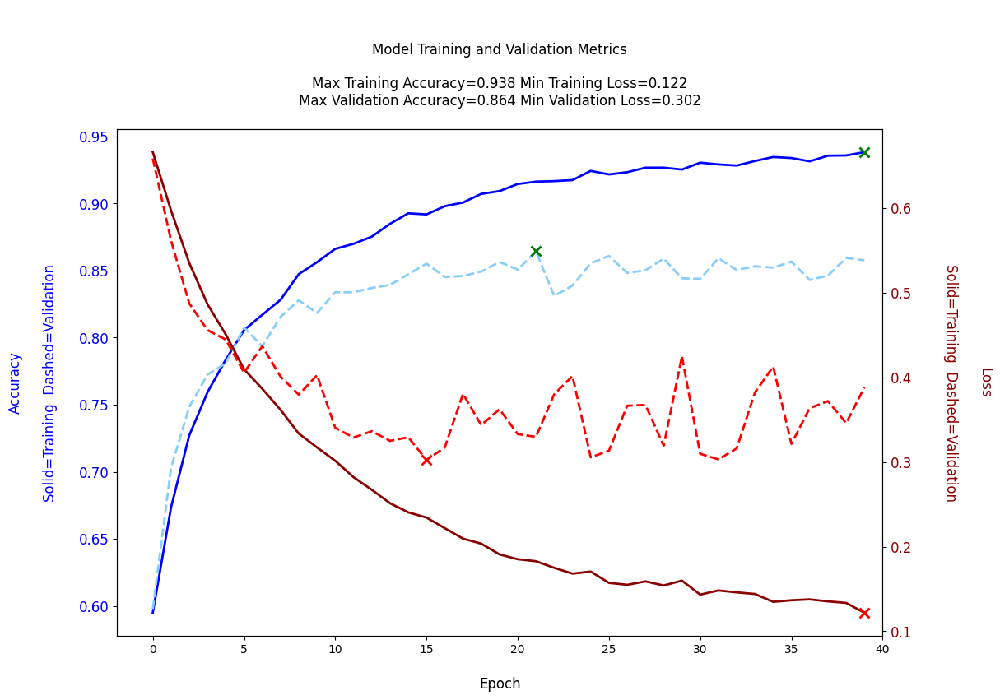

In [36]:
fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(111)

ind_xta = np.argmax(history.history['accuracy'])
ind_xva = np.argmax(history.history['val_accuracy'])
ind_xtl = np.argmin(history.history['loss'])
ind_xvl = np.argmin(history.history['val_loss'])

plt.title('\n\nModel Training and Validation Metrics\n\n' +
          'Max Training Accuracy='+str("%.3f" % history.history['accuracy'][ind_xta])+' ' +
          'Min Training Loss='+str("%.3f" % history.history['loss'][ind_xtl])+'\n'+
          'Max Validation Accuracy='+str("%.3f" % history.history['val_accuracy'][ind_xva])+' ' +
          'Min Validation Loss='+str("%.3f" % history.history['val_loss'][ind_xvl])+'\n',size=12)

ax1.plot(history.history['accuracy'], color='blue', linestyle='-',linewidth=2)
plt.plot(history.history['val_accuracy'], color='lightskyblue', linestyle='--',linewidth=2)

ax1.set_xlabel('\nEpoch', size=12)
ax1.set_ylabel('Accuracy\n\nSolid=Training  Dashed=Validation\n', color='blue',size=12)
ax1.set_xlim(right=num_epochs)

plt.plot(ind_xta, history.history['accuracy'][ind_xta], 'gx', markersize=8, markeredgewidth=2)
plt.plot(ind_xva, history.history['val_accuracy'][ind_xva], 'gx', markersize=8, markeredgewidth=2)

for tl in ax1.get_yticklabels():
    tl.set_color('blue')
    tl.set_fontsize(12)
    
ax2 = ax1.twinx()
ax2.plot(history.history['loss'], color='darkred', linestyle='-',linewidth=2)
plt.plot(history.history['val_loss'], color='red', linestyle='--',linewidth=2)

ax2.set_ylabel('Loss\n\nSolid=Training  Dashed=Validation\n', color='darkred',size=12, rotation=270, labelpad=70)
plt.plot(ind_xtl, history.history['loss'][ind_xtl], 'rx', markersize=8, markeredgewidth=2)
plt.plot(ind_xvl, history.history['val_loss'][ind_xvl], 'rx', markersize=8, markeredgewidth=2)

for tl in ax2.get_yticklabels():
    tl.set_color('darkred')
    tl.set_fontsize(12)